In [14]:
import numpy as np
# import matplotlib.pyplot as plt
import pandas as pd

data_climate = pd.read_csv('../data/jena_climate_2009_2016.csv')
print(data_climate.columns)

Index(['Date Time', 'p (mbar)', 'T (degC)', 'Tpot (K)', 'Tdew (degC)',
       'rh (%)', 'VPmax (mbar)', 'VPact (mbar)', 'VPdef (mbar)', 'sh (g/kg)',
       'H2OC (mmol/mol)', 'rho (g/m**3)', 'wv (m/s)', 'max. wv (m/s)',
       'wd (deg)'],
      dtype='object')


In [15]:
temperature = data_climate['T (degC)']
raw_data = data_climate.drop(columns=['Date Time', 'T (degC)'])
print(raw_data.shape)

(420551, 13)


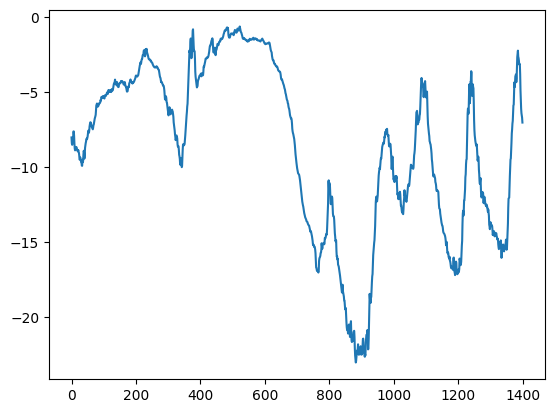

In [16]:
import matplotlib.pyplot as plt

plt.plot(range(len(temperature[:1400])), temperature[:1400]);

In [17]:
train_values = 0.5 * len(data_climate)
val_values = test_values = 0.25 * len(data_climate)

train_data = raw_data[:int(train_values)]
val_data = raw_data[int(train_values):int(train_values + val_values)]
test_data = raw_data[int(train_values + val_values):]

print(train_data.shape, val_data.shape, test_data.shape)

(210275, 13) (105138, 13) (105138, 13)


In [18]:
from keras.layers import LSTM

mean = train_data.mean(axis=0)
raw_data -= mean
std_dev = train_data.std(axis=0)
raw_data /= std_dev

mean

p (mbar)            988.748898
Tpot (K)            282.904641
Tdew (degC)           4.312734
rh (%)               75.871407
VPmax (mbar)         13.144940
VPact (mbar)          9.193617
VPdef (mbar)          3.951248
sh (g/kg)             5.810175
H2OC (mmol/mol)       9.301560
rho (g/m**3)       1218.453496
wv (m/s)              2.149935
max. wv (m/s)         3.560588
wd (deg)            176.441517
dtype: float64

In [19]:
int(train_values)

210275

In [20]:
raw_data.shape

(420551, 13)

In [23]:
yt = [23, 33, 23, 23, 5, 4, 58, 65, 32, 34, 5, 232, 634, 54, 34]
yt[:-5], yt[:5], yt[-5:], yt[5:]

([23, 33, 23, 23, 5, 4, 58, 65, 32, 34],
 [23, 33, 23, 23, 5],
 [5, 232, 634, 54, 34],
 [4, 58, 65, 32, 34, 5, 232, 634, 54, 34])

In [21]:
from keras.utils import timeseries_dataset_from_array

sequence_length = 120
sampling_rate = 6
target = sampling_rate * (sequence_length + (24 - 1))
batch_size = 256


train_set = timeseries_dataset_from_array(
    data=raw_data[:-target],
    targets=temperature[target:],
    sequence_length=sequence_length,
    sampling_rate=sampling_rate,
    shuffle=True,
    start_index=0,
    end_index=int(train_values),
    batch_size=batch_size
)

val_set = timeseries_dataset_from_array(
    data=raw_data[:-target],
    targets=temperature[target:],
    sequence_length=sequence_length,
    sampling_rate=sampling_rate,
    shuffle=True,
    start_index=int(train_values),
    end_index=(int(train_values) +int(val_values)),
    batch_size=batch_size
)

test_set = timeseries_dataset_from_array(
    data=raw_data[:-target],
    targets=temperature[target:],
    sequence_length=sequence_length,
    sampling_rate=sampling_rate,
    shuffle=True,
    start_index=(int(train_values) +int(val_values)),
    batch_size=batch_size
)

In [22]:
from keras.layers import LSTM, Input, Dropout, Dense
from keras import Model
from keras.callbacks import ModelCheckpoint

inputs = Input(shape=(sequence_length, raw_data.shape[1]))
x = LSTM(12, recurrent_dropout=0.25)(inputs)
x = Dropout(0.5)(x)
outputs = Dense(1)(x)

model = Model(inputs, outputs)

callbacks = ModelCheckpoint(
    'models/baseline_lstm.keras',
    save_best_only=True
)

model.compile(optimizer='rmsprop', loss='mse', metrics=['mae'])

history = model.fit(train_set,
                    epochs=50,
                    validation_data=val_set,
                    callbacks=callbacks)

Epoch 1/50


216/819 ━━━━━━━━━━━━━━━━━━━━ 29s 48ms/step - loss: 126.6783 - mae: 9.2275

KeyboardInterrupt: 

In [42]:
[([x for x in inp[i]], tar[i]) for inp, tar in train_set for i in range(3)]

[([<tf.Tensor: shape=(13,), dtype=float64, numpy=
   array([ 0.298807  ,  1.41972961,  1.54918234, -0.51370419,  1.66896166,
           1.97667341,  0.94121974,  1.96380541,  1.96184162, -1.29973028,
           3.03210226,  2.39757205,  0.34433743])>,
   <tf.Tensor: shape=(13,), dtype=float64, numpy=
   array([ 0.30586238,  1.42198577,  1.58590867, -0.45295996,  1.67422442,
           2.046611  ,  0.88879872,  2.03597866,  2.03328142, -1.30401248,
           2.36700522,  1.69587455,  0.43986218])>,
   <tf.Tensor: shape=(13,), dtype=float64, numpy=
   array([ 0.33525977,  1.4084488 ,  1.65936132, -0.28696581,  1.65448906,
           2.19130947,  0.72943884,  2.18032515,  2.17616102, -1.29402068,
           1.55193532,  1.32134888,  0.33152313])>,
   <tf.Tensor: shape=(13,), dtype=float64, numpy=
   array([ 0.38464738,  1.38814336,  1.68619979, -0.1967516 ,  1.62291248,
           2.24436557,  0.63508101,  2.22970685,  2.22616888, -1.27023069,
           1.16070177,  0.83489601,  0.31404

In [ ]:
history.history

{'loss': [65.87857055664062,
  25.481477737426758,
  21.370492935180664,
  19.832502365112305,
  18.996299743652344,
  18.369386672973633,
  17.78606414794922,
  17.31998634338379,
  16.92806625366211,
  16.6699275970459,
  16.34821128845215,
  16.23188591003418,
  16.084264755249023,
  15.901719093322754,
  15.905842781066895,
  15.741934776306152,
  15.786601066589355,
  15.764528274536133,
  15.654402732849121,
  15.594706535339355,
  15.56291389465332,
  15.461308479309082,
  15.517333030700684,
  15.498558044433594,
  15.494351387023926,
  15.511492729187012,
  15.489943504333496,
  15.454700469970703,
  15.38516902923584,
  15.349785804748535,
  15.404732704162598,
  15.368607521057129,
  15.346807479858398,
  15.358428955078125,
  15.376354217529297,
  15.219281196594238,
  15.28452205657959,
  15.321106910705566,
  15.21604061126709,
  15.28777027130127,
  15.284577369689941,
  15.2863187789917,
  15.277294158935547,
  15.302359580993652,
  15.213523864746094,
  15.340434074401

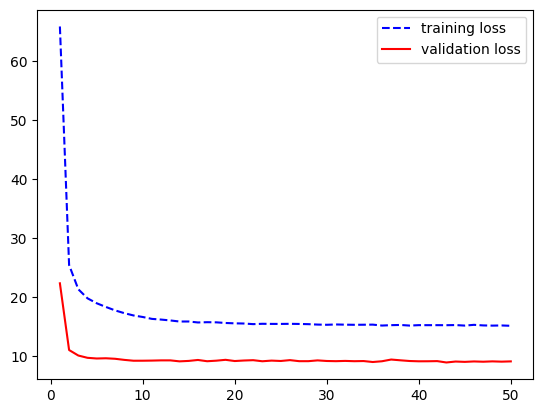

In [ ]:
plt.plot(range(1, 51), history.history['loss'], '--b', label='training loss')
plt.plot(range(1, 51), history.history['val_loss'], '-r', label='validation loss')
plt.legend();

In [ ]:
from keras.layers import GRU, Input, Dropout, Dense
from keras import Model
from keras.callbacks import ModelCheckpoint

inputs = Input(shape=(sequence_length, raw_data.shape[1]))
x = GRU(32, recurrent_dropout=0.25, return_sequences=True)(inputs)
x = GRU(32, recurrent_dropout=0.25)(x)
x = Dropout(0.5)(x)
outputs = Dense(1)(x)

model = Model(inputs, outputs)

callbacks = ModelCheckpoint(
    'models/baseline_gru.keras',
    save_best_only=True
)

model.compile(optimizer='rmsprop', loss='mse', metrics=['mae'])

history = model.fit(train_set,
                    epochs=50,
                    validation_data=val_set,
                    callbacks=callbacks)

Epoch 1/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 140s 166ms/step - loss: 22.8235 - mae: 3.5468 - val_loss: 9.4044 - val_mae: 2.3717
Epoch 2/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 115s 141ms/step - loss: 13.9683 - mae: 2.8983 - val_loss: 8.6394 - val_mae: 2.2779
Epoch 3/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 110s 134ms/step - loss: 13.1785 - mae: 2.8146 - val_loss: 8.6301 - val_mae: 2.2741
Epoch 4/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 110s 134ms/step - loss: 12.6945 - mae: 2.7622 - val_loss: 8.8936 - val_mae: 2.3187
Epoch 5/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 114s 139ms/step - loss: 12.2271 - mae: 2.7128 - val_loss: 8.6712 - val_mae: 2.2835
Epoch 6/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 115s 141ms/step - loss: 11.8971 - mae: 2.6793 - val_loss: 8.4650 - val_mae: 2.2522
Epoch 7/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 117s 142ms/step - loss: 11.5343 - mae: 2.6352 - val_loss: 8.5043 - val_mae: 2.2624
Epoch 8/50
819/819 ━━━━━━━━━━━━━━━━━━━━ 118s 144ms/step - loss: 11.1635 - mae: 2.5992 - val_loss: 9.2759 - val_mae: 2.3743
Epoch 9/50
819/8

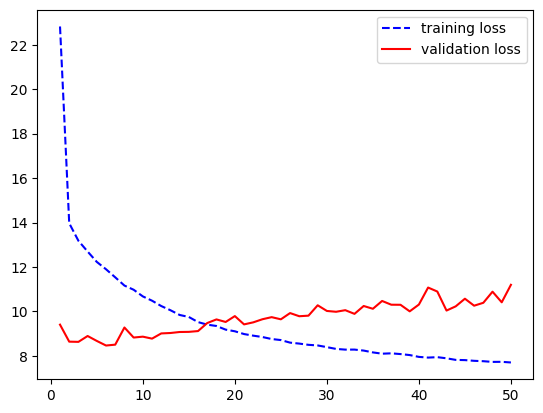

In [26]:
plt.plot(range(1, 51), history.history['loss'], '--b', label='training loss')
plt.plot(range(1, 51), history.history['val_loss'], '-r', label='validation loss')
plt.legend();


In [43]:
 !curl-O https:/ /ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz
 !tar-xf aclImdb_v1.tar.gz

'curl-O' is not recognized as an internal or external command,
operable program or batch file.
'tar-xf' is not recognized as an internal or external command,
operable program or batch file.


In [44]:
import urllib.request
import tarfile

# Download file
url = "https://ai.stanford.edu/~amaas/data/sentiment/aclImdb_v1.tar.gz"
urllib.request.urlretrieve(url, "aclImdb_v1.tar.gz")

# Extract file
with tarfile.open("aclImdb_v1.tar.gz", "r:gz") as tar:
    tar.extractall()


C:\Users\HP\AppData\Local\Temp\ipykernel_11792\100187836.py:10: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tar.extractall()


In [51]:
import os, pathlib, shutil, random

base_dir = pathlib.Path("aclImdb")
val_dir = base_dir / "val" 
train_dir = base_dir / "train" 

for category in ("neg", "pos"):
    os.makedirs(val_dir / category)
    files = os.listdir(train_dir / category)
    random.Random(1337).shuffle(files)   
    num_val_samples = int(0.2 * len(files))  
    val_files = files[-num_val_samples:]  
    for fname in val_files:    
        shutil.move(train_dir / category / fname, val_dir / category / fname) 

In [12]:
from tensorflow.keras.utils import text_dataset_from_directory

batch_size = 32
train_dataset = text_dataset_from_directory('aclImdb/train', batch_size=batch_size)
val_dataset = text_dataset_from_directory('aclImdb/val', batch_size=batch_size)
test_dataset = text_dataset_from_directory('aclImdb/test', batch_size=batch_size)

Found 20000 files belonging to 2 classes.
Found 5000 files belonging to 2 classes.
Found 25000 files belonging to 2 classes.


In [13]:
from tensorflow.keras.layers import TextVectorization

max_features = 20000

tect_vectorization = TextVectorization(
    max_tokens=max_features,
    output_mode='multi_hot',
)
text_only_train = train_dataset.map(lambda x, y: x)
tect_vectorization.adapt(text_only_train)
# text_only_train.list_files

In [6]:
binary_1gram_train = train_dataset.map(lambda x, y: (tect_vectorization(x), y), num_parallel_calls=4)
binary_1gram_val = val_dataset.map(lambda x, y: (tect_vectorization(x), y), num_parallel_calls=4)
binary_1gram_test = test_dataset.map(lambda x, y: (tect_vectorization(x), y), num_parallel_calls=4)

In [14]:
from tensorflow import keras 
from tensorflow.keras import layers
def get_model(max_tokens=20000, hidden_dim=16):
    inputs = keras.Input(shape=(max_tokens,))
    x = layers.Dense(hidden_dim, activation="relu")(inputs)
    x = layers.Dropout(0.5)(x)
    outputs = layers.Dense(1, activation="sigmoid")(x)
    model = keras.Model(inputs, outputs)
    model.compile(optimizer="rmsprop",
            loss="binary_crossentropy",
            metrics=["accuracy"])
    return model

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint
model = get_model()
model.summary()

callbacks = ModelCheckpoint('models/baseline_dense.keras',
    save_best_only=True)
model.fit(
    binary_1gram_train,
    validation_data=binary_1gram_val,
    epochs=10,
    callbacks=[callbacks]
)
model_imported = keras.models.load_model('models/baseline_dense.keras')
print(f'Test accuracy: {model_imported.evaluate(binary_1gram_test)[1]:.3f}')

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 20000)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_2 (Dense)                 │ (None, 16)             │       320,016 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 16)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 1)              │            17 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 320,033 (1.22 MB)

 Trainable params: 320,033 (1.22 MB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/10


625/625 ━━━━━━━━━━━━━━━━━━━━ 12s 18ms/step - accuracy: 0.8250 - loss: 0.4129 - val_accuracy: 0.8786 - val_loss: 0.3014
Epoch 2/10
621/625 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - accuracy: 0.8934 - loss: 0.2886

In [11]:
model.history

AttributeError: 'Functional' object has no attribute 'history'

ValueError: not enough values to unpack (expected 3, got 2)

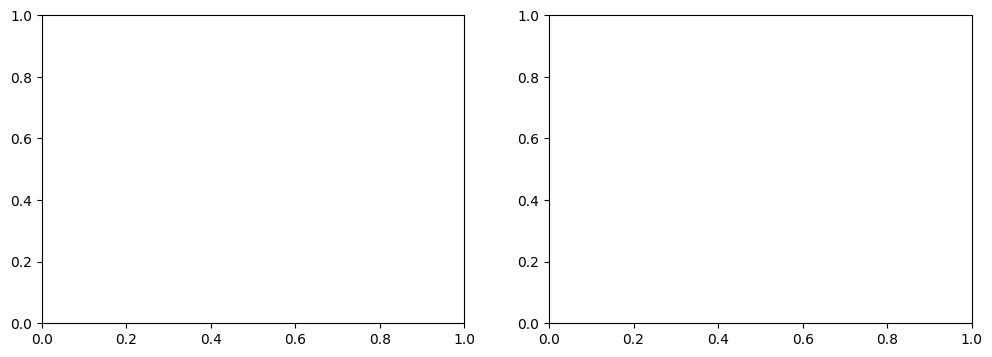

In [10]:
import matplotlib.pyplot as plt

history = model

fig, ax1, ax2 =  plt.subplots(1, 2, figsize=(12, 4))
ax1.plot(range(1, 11), history.history['accuracy'], '--b', label='training accuracy')
ax1.plot(range(1, 11), history.history['val_accuracy'], '-r', label='validation accuracy')
ax2.plot(range(1, 11), history.history['loss'], '--b', label='training loss')
ax2.plot(range(1, 11), history.history['val_loss'], '-r', label='validation loss')
plt.legend();